In [1]:
### testing cellpose model & parameters before running automated scripts make_mask.py, process_mask.py:

import cellpose
from cellpose import utils, io, models, core
from cellpose import plot
import numpy
import matplotlib.pyplot as plt
import skimage.io
import shutil
import os
import cv2
import glob
from scipy import ndimage
import time
import pandas
import warnings
warnings.filterwarnings('ignore')

In [2]:
treatments = pandas.read_csv('treatments.txt', sep='\t')
print(treatments.shape)
treatments.head()

(240, 2)


,well,guide
0,C03,non-targeting_00999
1,C05,LAMP1
2,C07,LMNB2
3,C09,DYRK1A
4,C11,PICALM


In [3]:
print(treatments.well.nunique())
print(treatments.guide.nunique())

240
30


In [4]:
# path = 'raw_imgs/plate'
path = 'rescaled_imgs/plate'

In [5]:
def make_dic(dic, path):

    for x in glob.glob(path + '*.tif'):
        if x.split('_')[-3] + '_' + x.split('_')[-2] in dic.keys():
            dic[x.split('_')[-3] + '_' + x.split('_')[-2]].append(x)
        else: dic[x.split('_')[-3] + '_' + x.split('_')[-2]] = [x]
    print(len(dic))
    
    for x, y in dic.items():
        dic[x] = sorted(y)

In [6]:
dic1 = dict()
make_dic(dic1, path+'1/')

859


In [7]:
dic2 = dict()
make_dic(dic2, path+'2/')

854


In [8]:
dic3 = dict()
make_dic(dic3, path+'3/')

0


In [9]:
dic4 = dict()
make_dic(dic4, path+'4/')

853


In [10]:
w = {'tubulin': 0, 'mito': 1, 'lysosome': 2, 'dapi': 3, 'brightfield': 4}

In [16]:
# function to display images:
def view_img(dc, well):#, channel):

    t = io.imread(dc[well][w['tubulin']])
    m = io.imread(dc[well][w['mito']])
    l = io.imread(dc[well][w['lysosome']])
    # mask = numpy.load('masks/mask_' + well + '.npy')
    
    # fig = plt.figure(figsize=(36, 20))
    fig = plt.figure()

    fig, ax = plt.subplots(nrows=1, ncols=3)

    ax[0].imshow(t, cmap='gray')
    ax[0].set_title('tubulin')
    ax[0].axis('off')

    ax[1].imshow(m, cmap='gray')
    ax[1].set_title('mitochondria')
    ax[1].axis('off')

    ax[2].imshow(l, cmap='gray')
    ax[2].set_title('lysosome')
    ax[2].axis('off')

    plt.suptitle(well, y=.775, fontsize=12)
    fig.tight_layout()
    plt.show()

<Figure size 640x480 with 0 Axes>

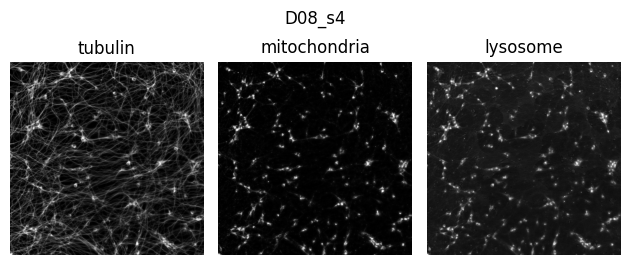

In [17]:
view_img(dic1, 'D08_s4')

In [23]:
# function to get masks & print segmentation results:
## for tubulin or mito or lyso images + DAPI
## prints number of segmented cells in addition to figures

def get_mask(dc, channel, well, diam):

    #cellpose3 built-in model:
    model = models.Cellpose(gpu=True, model_type='cyto3')
    
    img = cv2.imread(dc[well][w[channel]], cv2.IMREAD_GRAYSCALE)
    dapi = cv2.imread(dc[well][w['dapi']], cv2.IMREAD_GRAYSCALE)
    stack = cv2.merge((img, dapi))

    mask, flows, styles, diams = model.eval(stack, diameter=diam, channels=[0,0])

    print(len(numpy.unique(mask)))
    print(well + ' - ' + channel)
    fig = plt.figure(figsize=(36, 20))
    plot.show_segmentation(fig, stack, mask, flows[0], channels=[1,3])
    plt.tight_layout()

In [19]:
# function to get masks & print results - finetuned model from P.G.:

def finetune_get_mask(dc, channel, well, diam):
    model = models.CellposeModel(gpu=True,  model_type='/home/ymoshfegh/1014e/20230926/CP_GCaMP')
    img = cv2.imread(dc[well][w[channel]], cv2.IMREAD_GRAYSCALE)
    dapi = cv2.imread(dc[well][w['dapi']], cv2.IMREAD_GRAYSCALE)
    stack = cv2.merge((img, dapi))

    # mask, flows, styles = model.eval(img, diameter=diam, channels=[1,3])
    mask, flows, styles = model.eval(stack, diameter=diam, channels=[0,0])

    print(len(numpy.unique(mask)))
    print(well + ' - ' + channel)
    fig = plt.figure(figsize=(36, 20))
    plot.show_segmentation(fig, stack, mask, flows[0], channels=[1,3])
    plt.tight_layout()

2096
E05_s2 - tubulin


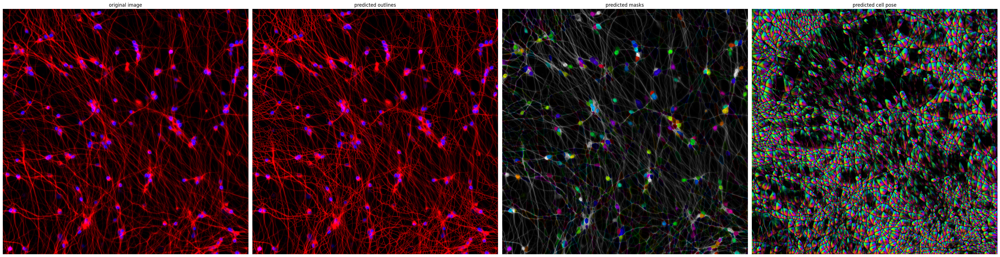

In [20]:
get_mask(dic1, 'tubulin', 'E05_s2', 25)

203
E05_s2 - tubulin


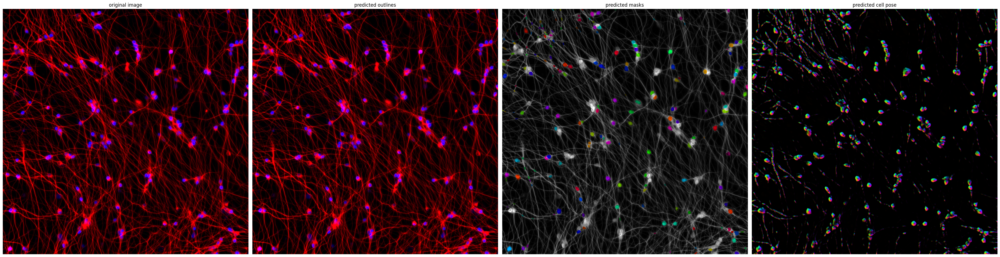

In [22]:
# finetuned:
finetune_get_mask(dic1, 'tubulin', 'E05_s2', None)

195
E05_s2 - mito


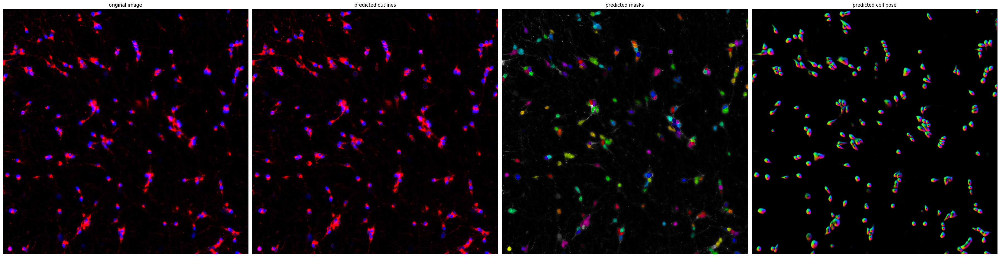

In [24]:
get_mask(dic1, 'mito', 'E05_s2', None)

143
E05_s2 - mito


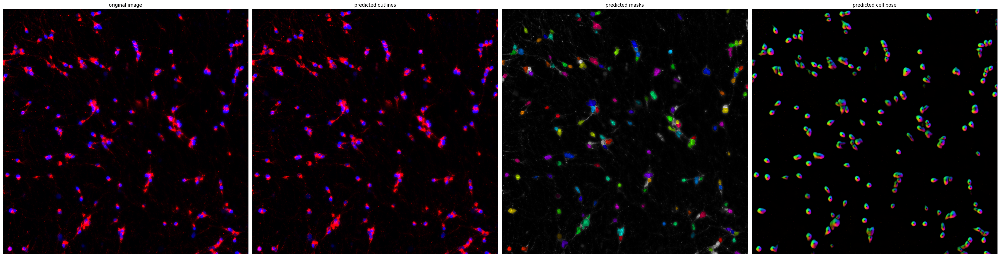

In [25]:
# finetuned:
finetune_get_mask(dic1, 'mito', 'E05_s2', 50)

255
E05_s2 - lysosome


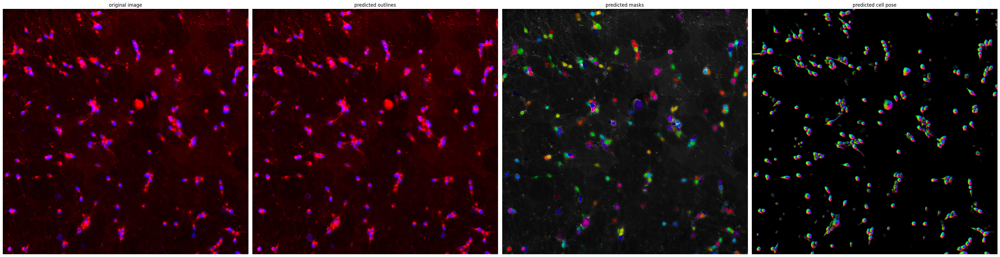

In [26]:
get_mask(dic1, 'lysosome', 'E05_s2', None)

136
E05_s2 - lysosome


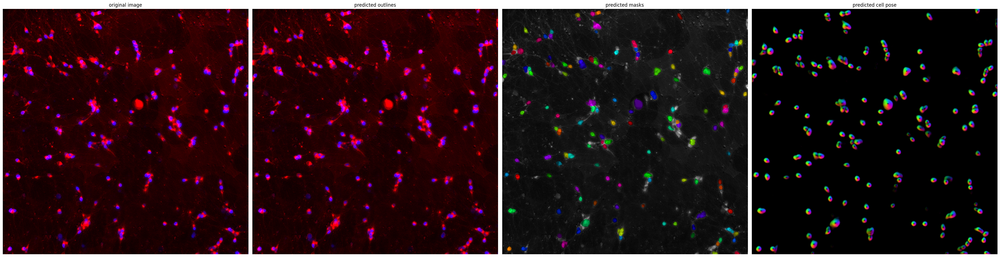

In [27]:
# finetuned:
finetune_get_mask(dic1, 'lysosome', 'E05_s2', 50)

203
E05_s2 - dapi


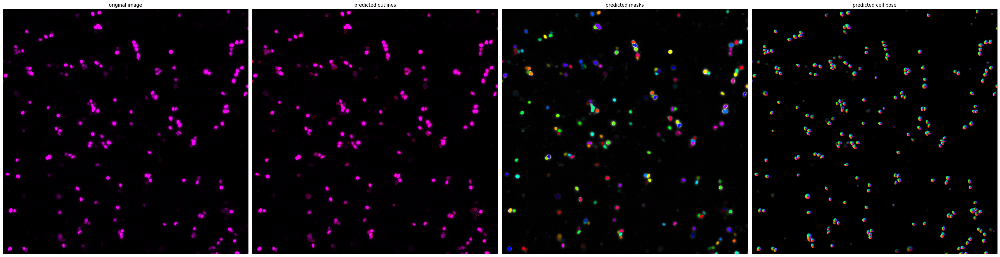

In [28]:
get_mask(dic1, 'dapi', 'E05_s2', None)

# ***calcein segmentation coming soon...***